In [1]:
%matplotlib inline
import matplotlib
import seaborn as sns
matplotlib.rcParams['savefig.dpi'] = 144

In [2]:
import pandas as pd
import numpy as np

from bokeh.plotting import figure, output_file, show, ColumnDataSource
from bokeh.io import output_notebook
from bokeh.palettes import Spectral6
from ipywidgets import *
from bokeh.layouts import row, widgetbox
from bokeh.models import CustomJS, Slider, ColumnDataSource
from bokeh.layouts import column, layout
from bokeh.models.widgets import Button
import matplotlib.ticker as mtick
import matplotlib.pyplot as plt
from scipy import fft, arange
import midi
import librosa
import librosa.display

In [3]:
import IPython.display

mono_ori, fs = librosa.load('chpn_op10_e01_format0.wav', sr = 44100)

mono_gen, fs = librosa.load('generated_chord_0.wav', sr = 44100)

In [4]:
import random

def make_clip(mono, sec):
    # a sec contains 44100 data points at 44.k frequency
    sec_clip = sec*44100
    
    # start at a randomly selected point in the sound clip by index,
    # and clip subsequest datapoints if there's enough datapoints left
    x = random.choice(range(len(mono)))
    
    while True:
        clip = mono[x:(x+sec_clip)]
        
        if len(clip) < len(mono):
            break
        
    return clip

In [5]:
# Obtain clips from original and generated song pieces
sec = 10 # 10 seconds of clip

clip_ori = make_clip(mono_ori, sec)
clip_gen = make_clip(mono_gen, sec)

In [6]:
IPython.display.Audio(data=clip_ori , rate=fs)

In [7]:
IPython.display.Audio(data=clip_gen , rate=fs)

CPU times: user 449 ms, sys: 4.81 ms, total: 454 ms
Wall time: 485 ms


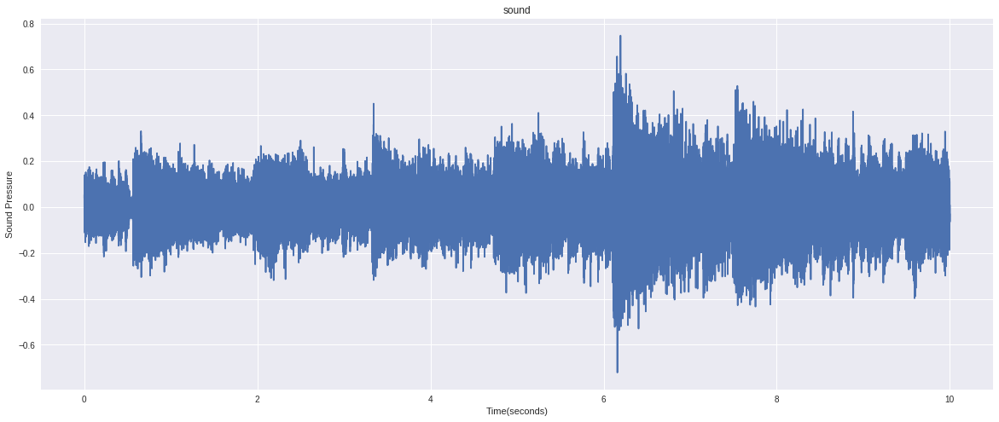

In [8]:
%%time
from IPython.core.pylabtools import figsize
figsize(20, 8)

T = len(clip_ori)/44100.0
t = np.linspace(0,T, len(clip_ori)) # reconstructed timestamps

plt.plot(t,clip_ori)
plt.title("sound")
plt.xlabel("Time(seconds)")
plt.ylabel("Sound Pressure")

In [9]:
sec = 2

clip_1 = make_clip(mono_ori, sec)
clip_2 = make_clip(mono_gen, sec)

In [10]:
import pickle

output_notebook()  # output bokeh plots in ipynb
TOOLS = "pan, reset, save" # , box_zoom, wheel_zoom,save

def waveform(original_clip=mono_ori, generated_clip=mono_gen, sec = 1):
    
    clip_1 = make_clip(mono_ori, sec)
    clip_2 = make_clip(mono_gen, sec)
    
    T = (len(clip_1)/44100)
    t_1 = np.linspace(0,T, len(clip_1)) # reconstructed timestamps
    
    T = (len(clip_2)/44100)
    t_2 = np.linspace(0,T, len(clip_2)) # reconstructed timestamps
    
    # Definte Plot Structures
    # Plot 1
    plot_1 = figure(tools=TOOLS, title="Waveform of Musical Composition", x_axis_label="Time(seconds)", x_axis_type="auto",
                    y_axis_label = "Sound Pressure", plot_width=1000, plot_height=400, x_range=(0, 0.01))
    # Plot 2
    plot_2 = figure(tools=TOOLS, title="Waveform of Generated Composition", x_axis_label="Time(seconds)", x_axis_type="auto", 
                    y_axis_label = "Sound Pressure", plot_width=1000, plot_height=400, x_range=(0, 0.01))    

    # add a line renderer
    plot_1.line(t_1, clip_1)
    plot_2.line(t_2, clip_2)

    # stack plots on top of each other   
    layout = column(plot_1, plot_2)

    show(layout)
    
    with open('wf_clip_1.pkl', 'wb') as output:
        pickle.dump(clip_1, output, pickle.HIGHEST_PROTOCOL)

    with open('wf_clip_2.pkl', 'wb') as output:
        pickle.dump(clip_2, output, pickle.HIGHEST_PROTOCOL)

Loading BokehJS ...

In [11]:
waveform(mono_ori, mono_gen, sec=2) # stretch it out  even further

In [12]:
import pickle

with open('wf_clip_1.pkl', 'rb') as input:
    wf_clip_1 = pickle.load(input)

with open('wf_clip_2.pkl', 'rb') as input:
    wf_clip_2 = pickle.load(input)

IPython.display.Audio(data=wf_clip_1 , rate=fs)

In [13]:
IPython.display.Audio(data=wf_clip_2 , rate=fs)

In [14]:
import pickle

output_notebook()  # output bokeh plots in ipynb
TOOLS = "pan, reset, save" # , box_zoom, wheel_zoom, pan, save

def note_detection(original_clip=mono_ori, generated_clip=mono_gen, sec = 10): #
    
    clip_1 = make_clip(mono_ori, sec)
    rel_amp_1 = (clip_1**2)/44100
    clip_2 = make_clip(mono_gen, sec)
    rel_amp_2 = (clip_2**2)/44100
    
    T = (len(rel_amp_1)/44100)
    t_1 = np.linspace(0,T, len(rel_amp_1)) # reconstructed timestamps
    
    T = (len(rel_amp_2)/44100)
    t_2 = np.linspace(0,T, len(rel_amp_2)) # reconstructed timestamps
    
    # Definte Plot Structures
    plot_1 = figure(tools=TOOLS, title="Peaks Representing Notes Played(Musical Composition)", x_axis_label="Time(seconds)", x_axis_type="auto",
                    y_axis_label = "Relative Amplitude", plot_width=1000, plot_height=400, x_range=(0, 2))
    plot_2 = figure(tools=TOOLS, title="Peaks Representing Notes Played(Generated Composition)", x_axis_label="Time(seconds)", x_axis_type="auto", 
                    y_axis_label = "Relative Amplitude", plot_width=1000, plot_height=400, x_range=(0, 2))
    
    # add a line renderer
    plot_1.line(t_1, rel_amp_1)
    plot_2.line(t_2, rel_amp_2)

    # stack plots on top of each other   
    layout = column(plot_1, plot_2)

    show(layout)
    
    with open('rel_amp_clip_1.pkl', 'wb') as output:
        pickle.dump(clip_1, output, pickle.HIGHEST_PROTOCOL)

    with open('rel_amp_clip_2.pkl', 'wb') as output:
        pickle.dump(clip_2, output, pickle.HIGHEST_PROTOCOL)

Loading BokehJS ...

In [15]:
%%time
note_detection(mono_ori, mono_gen, sec=2)

CPU times: user 3.48 s, sys: 132 ms, total: 3.61 s
Wall time: 3.74 s


In [16]:
import pickle

with open('rel_amp_clip_1.pkl', 'rb') as input:
    rel_amp_clip_1 = pickle.load(input)

with open('rel_amp_clip_2.pkl', 'rb') as input:
    rel_amp_clip_2 = pickle.load(input)

IPython.display.Audio(data=rel_amp_clip_1 , rate=fs)

In [17]:
IPython.display.Audio(data=rel_amp_clip_2 , rate=fs)

In [18]:
import pickle

output_notebook()  # output bokeh plots in ipynb
TOOLS = "pan, reset, save" # , box_zoom, wheel_zoom, pan, save

def spectral_analysis_plot(original_clip=mono_ori, generated_clip=mono_gen, sec = 4):
    
    Fs = 44100.0                        # sampling rate
    
    # Computation for Original Clip
    clip_1 = make_clip(mono_ori, sec)   
    n_1 = len(clip_1)                   # length of the signal
    k_1 = arange(n_1)
    T_1 = len(clip_1)/Fs                # sampling interval
    frq = k_1/T_1                       # two sides frequency range
    frq_1 = frq[range(n_1/2)]           # one side frequency range
    Y = fft(clip_1)/n_1                 # fft computing and normalization
    Y = Y.real
    spectral_clip_1 = Y[range(n_1/2)]
    
    # Computation for Gnerated Clip
    clip_2 = make_clip(mono_gen, sec)   
    n_2 = len(clip_2)                   # length of the signal
    k_2 = arange(n_2)
    T_2 = len(clip_2)/Fs                # sampling interval
    frq = k_2/T_2                       # two sides frequency range
    frq_2 = frq[range(n_2/2)]           # one side frequency range
    Y = fft(clip_2)/n_2                 # fft computing and normalization
    Y = Y.real
    spectral_clip_2 = Y[range(n_2/2)]
    
    # Definte Plot Structures
    plot_1 = figure(tools=TOOLS, title="Spectral Analysis (Musical Composition)", x_axis_label="Frequency (Hz)", x_axis_type="auto",
                    y_axis_label = "Amplitude", plot_width=1000, plot_height=400)
    plot_2 = figure(tools=TOOLS, title="Spectral Analysis (Generated Composition)", x_axis_label="Frequency (Hz)", x_axis_type="auto", 
                    y_axis_label = "Amplitude", plot_width=1000, plot_height=400)
    
    x_1 = np.linspace(start=0, stop=4200, num=len(frq_1))
    x_2 = np.linspace(start=0, stop=4200, num=len(frq_2))
    # add a line renderer
    plot_1.line(x_1, abs(spectral_clip_1))
    plot_2.line(x_2, abs(spectral_clip_2))

    # stack plots on top of each other   
    layout = column(plot_1, plot_2)

    show(layout)
    
    with open('spectral_clip_1.pkl', 'wb') as output:
        pickle.dump(clip_1, output, pickle.HIGHEST_PROTOCOL)

    with open('spectral_clip_2.pkl', 'wb') as output:
        pickle.dump(clip_2, output, pickle.HIGHEST_PROTOCOL)

Loading BokehJS ...

In [19]:
%%time
spectral_analysis_plot(mono_ori, mono_gen, sec=3)

CPU times: user 594 ms, sys: 23.7 ms, total: 617 ms
Wall time: 617 ms


In [20]:
import pickle

with open('spectral_clip_1.pkl', 'rb') as input:
    spectral_clip_1 = pickle.load(input)

with open('spectral_clip_2.pkl', 'rb') as input:
    spectral_clip_2 = pickle.load(input)

IPython.display.Audio(data=spectral_clip_1 , rate=fs)

In [21]:
IPython.display.Audio(data=spectral_clip_2 , rate=fs)

In [22]:
%%time
from IPython.core.pylabtools import figsize
figsize(30, 35)

def spectral_analysis_plot_full_data(mono_ori, mono_gen):
    
    Fs = 44100.0                        # sampling rate
    
    # Computation for Original Clip
    n_1 = len(mono_ori)                 # length of the signal
    k_1 = arange(n_1)
    T_1 = len(mono_ori)/Fs              # sampling interval
    frq = k_1/T_1                       # two sides frequency range
    frq_1 = frq[range(n_1/2)]           # one side frequency range
    Y_ori = fft(mono_ori)/n_1           # fft computing and normalization
    Y_ori = Y_ori.real
    spectral_clip_1 = Y_ori[range(n_1/2)]
    
    # Computation for Generated Clip
    n_2 = len(mono_gen)                 # length of the signal
    k_2 = arange(n_2)
    T_2 = len(mono_gen)/Fs              # sampling interval
    frq = k_2/T_2                       # two sides frequency range
    frq_2 = frq[range(n_2/2)]           # one side frequency range
    Y_gen = fft(mono_gen)/n_2           # fft computing and normalization
    Y_gen = Y_gen.real
    spectral_clip_2 = Y_gen[range(n_2/2)]
    
    a = np.linspace(start=0, stop=4200, num=len(frq_1)) # np.linspace(0, 44100/10.5, len(mono_ori))
    b = spectral_clip_1

    c = np.linspace(start=0, stop=4200, num=len(frq_2))
    d = spectral_clip_2

    plt.figure(1)
    plt.subplot(211)
    plt.plot(a,abs(b))
    plt.title("Spectral Analysis (Original Composition)", size = 40)
    plt.xlabel("Frequency (Hz)", size = 30)
    plt.xticks(np.arange(min(a), max(a)+1, 200), size = 25, rotation='vertical')
    plt.ylabel("Amplitude", size = 30)
    plt.yticks(size = 25)
    plt.ticklabel_format(style='sci', axis='y')

    plt.subplot(212)
    plt.plot(c,abs(d))
    plt.title("Spectral Analysis (Generated Composition)", size = 40)
    plt.xlabel("Frequency (Hz)", size = 30)
    plt.xticks(np.arange(min(c), max(c)+1, 200), size = 25, rotation='vertical')
    plt.ylabel("Amplitude", size = 30)
    plt.yticks(size = 25)
    plt.ticklabel_format(style='sci', axis='y')

    plt.show()

CPU times: user 0 ns, sys: 0 ns, total: 0 ns
Wall time: 56 µs


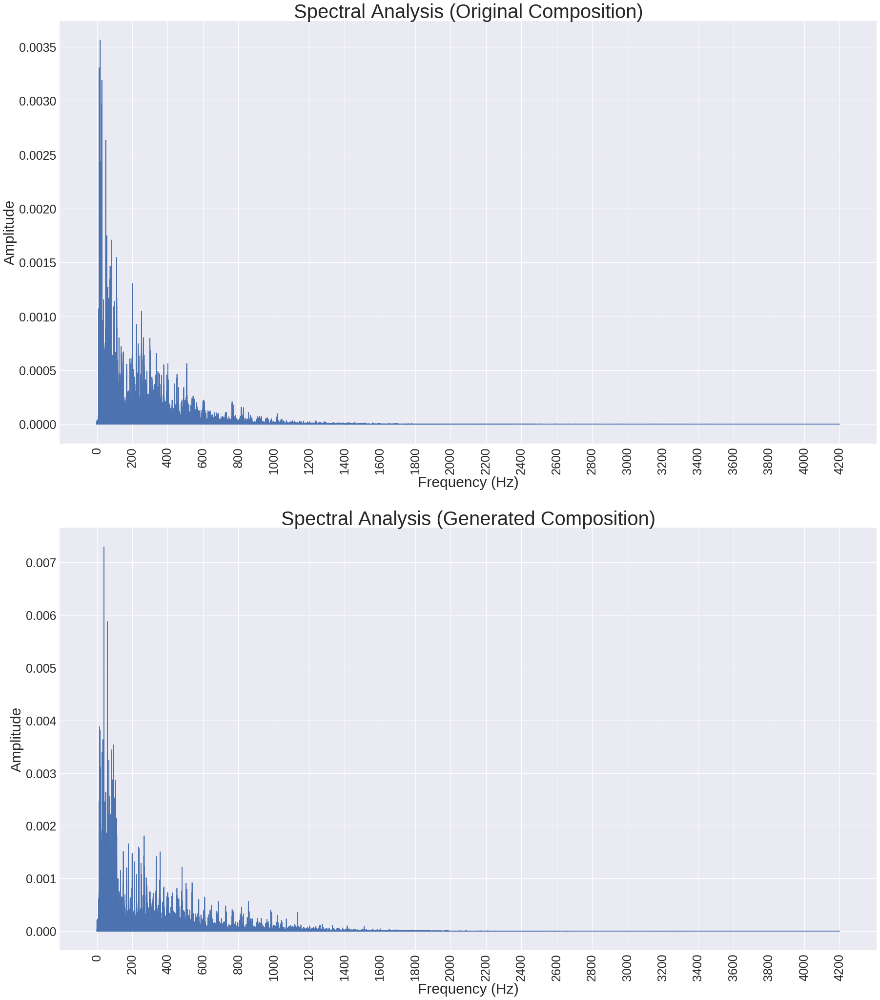

CPU times: user 13.9 s, sys: 1.08 s, total: 15 s
Wall time: 14.1 s


In [23]:
%%time
spectral_analysis_plot_full_data(mono_ori, mono_gen)

In [24]:
# Beat, Tempo, Rhythm, Melody, Harmony
# Beat is foundation of rhythm. beat pulsing of the musical piece
# Tempo is the speed of the beat, or beats per minute. it's assumed 60 BPM is normal and 120 BPM is twice as fast
# Rhythm is the organization of sound through time. LOL

In [94]:
%matplotlib inline
import matplotlib
from IPython.core.pylabtools import figsize
figsize(20, 13)

def graph_tempogram(mono_ori, mono_gen, fs=fs):
    
    y1 = mono_ori
    y2 = mono_gen
    sr = fs
    hop_length = 512
    
    # Compute Onset Strength
    ori_oenv = librosa.onset.onset_strength(y=y1, sr=sr, hop_length=hop_length)
    gen_oenv = librosa.onset.onset_strength(y=y2, sr=sr, hop_length=hop_length)
    # Compute Tempogram
    ori_tempogram = librosa.feature.tempogram(onset_envelope=ori_oenv, sr=sr, hop_length=hop_length)
    gen_tempogram = librosa.feature.tempogram(onset_envelope=gen_oenv, sr=sr, hop_length=hop_length)
    # Compute global onset autocorrelation
    ori_ac_global = librosa.autocorrelate(ori_oenv, max_size=ori_tempogram.shape[0])
    ori_ac_global = librosa.util.normalize(ori_ac_global)
    gen_ac_global = librosa.autocorrelate(gen_oenv, max_size=gen_tempogram.shape[0])
    gen_ac_global = librosa.util.normalize(gen_ac_global)
    # Estimate the global tempo for display purposes
    ori_tempo = librosa.beat.tempo(onset_envelope=ori_oenv, sr=sr, hop_length=hop_length)[0]
    gen_tempo = librosa.beat.tempo(onset_envelope=gen_oenv, sr=sr, hop_length=hop_length)[0]
    
    plt.figure(1)
    plt.subplot(211)
    freqs = librosa.tempo_frequencies(ori_tempogram.shape[0], hop_length=hop_length, sr=sr)
    plt.semilogx(freqs[1:], np.mean(ori_tempogram[1:], axis=1), label='Mean local autocorrelation', basex=2)
    plt.semilogx(freqs[1:], ori_ac_global[1:], '--', alpha=0.75, label='Global autocorrelation', basex=2)
    plt.axvline(ori_tempo, color='black', linestyle='--', alpha=.8, label='Estimated tempo={:g}'.format(ori_tempo))
    plt.legend(frameon=True)
    plt.title("Rhythm & Tempo (Original Composition)", size = 20, loc = "center")
    plt.xlabel('BPM', size = 15)
    plt.xticks(size = 15)
    plt.ylabel("Autocorrelation", size = 15)
    plt.yticks(size = 15)
    plt.axis('tight')
    plt.legend(frameon=True)
    
    plt.subplot(212)
    gen_freqs = librosa.tempo_frequencies(gen_tempogram.shape[0], hop_length=hop_length, sr=sr)
    plt.semilogx(freqs[1:], np.mean(gen_tempogram[1:], axis=1), label='Mean local autocorrelation', basex=2)
    plt.semilogx(freqs[1:], gen_ac_global[1:], '--', alpha=0.75, label='Global autocorrelation', basex=2)
    plt.axvline(gen_tempo, color='black', linestyle='--', alpha=.8, label='Estimated tempo={:g}'.format(gen_tempo))
    plt.legend(frameon=True)
    plt.title("Rhythm & Tempo (Generated Composition)", size = 20, loc = "center")
    plt.xlabel('BPM', size = 15)
    plt.xticks(size = 15)
    plt.ylabel("Autocorrelation", size = 15)
    plt.yticks(size = 15)
    plt.axis('tight')
    plt.legend(frameon=True)
    plt.savefig("graph_tempogram.png") 
    plt.show()

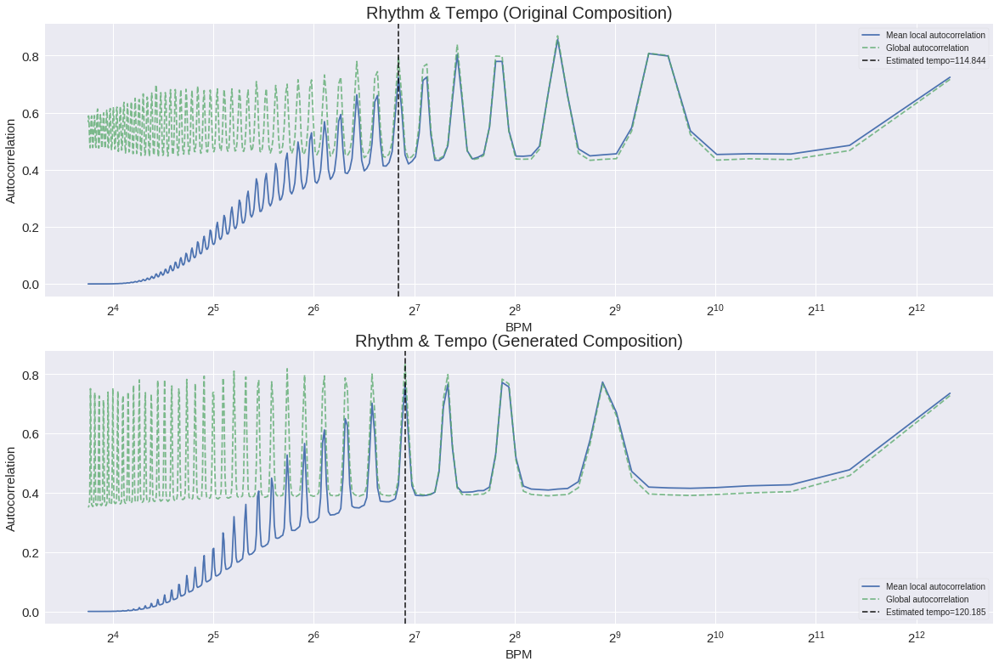

CPU times: user 24.9 s, sys: 3.77 s, total: 28.6 s
Wall time: 24.3 s


In [95]:
%%time
graph_tempogram(mono_ori, mono_gen, fs=fs)

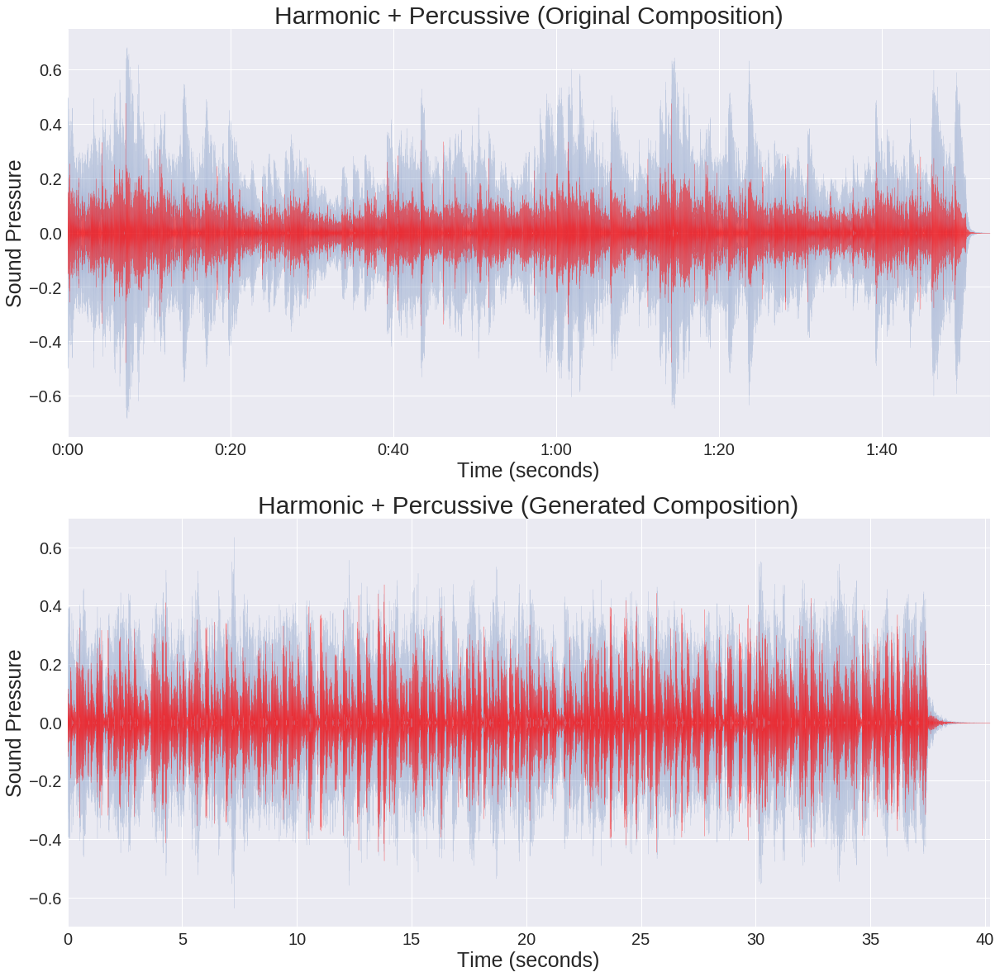

CPU times: user 43.7 s, sys: 2.11 s, total: 45.8 s
Wall time: 43.9 s


In [104]:
%%time
%matplotlib inline
import matplotlib
from IPython.core.pylabtools import figsize
figsize(20, 20)

mono_ori_harm, mono_ori_perc = librosa.effects.hpss(mono_ori)
mono_gen_harm, mono_gen_perc = librosa.effects.hpss(mono_gen)

plt.figure(1)
plt.subplot(211)
librosa.display.waveplot(mono_ori_harm, sr=fs, alpha=0.25)
librosa.display.waveplot(mono_ori_perc, sr=fs, color='r', alpha=0.5)
plt.title('Harmonic + Percussive (Original Composition)', size = 30)
plt.xlabel("Time (seconds)", size = 25)
plt.xticks(size = 20)
plt.ylabel("Sound Pressure", size = 25)
plt.yticks(size = 20)

plt.subplot(212)
librosa.display.waveplot(mono_gen_harm, sr=fs, alpha=0.25)
librosa.display.waveplot(mono_gen_perc, sr=fs, color='r', alpha=0.5)
plt.title('Harmonic + Percussive (Generated Composition)', size = 30)
plt.xlabel("Time (seconds)", size = 25)
plt.xticks(size = 20)
plt.ylabel("Sound Pressure", size = 25)
plt.yticks(size = 20)

plt.savefig("Harmonic_Percussive.png") 
plt.show()

In [102]:
hp_ori = np.append(mono_ori_harm[range(0, 4996096/11)], mono_ori_perc[range(0, 4996096/11)])
IPython.display.Audio(data=hp_ori, rate=fs)

In [103]:
hp_gen = np.append(mono_gen_harm[range(0, 1773056/4)], mono_gen_perc[range(0, 1773056/4)])
IPython.display.Audio(data=hp_gen, rate=fs)

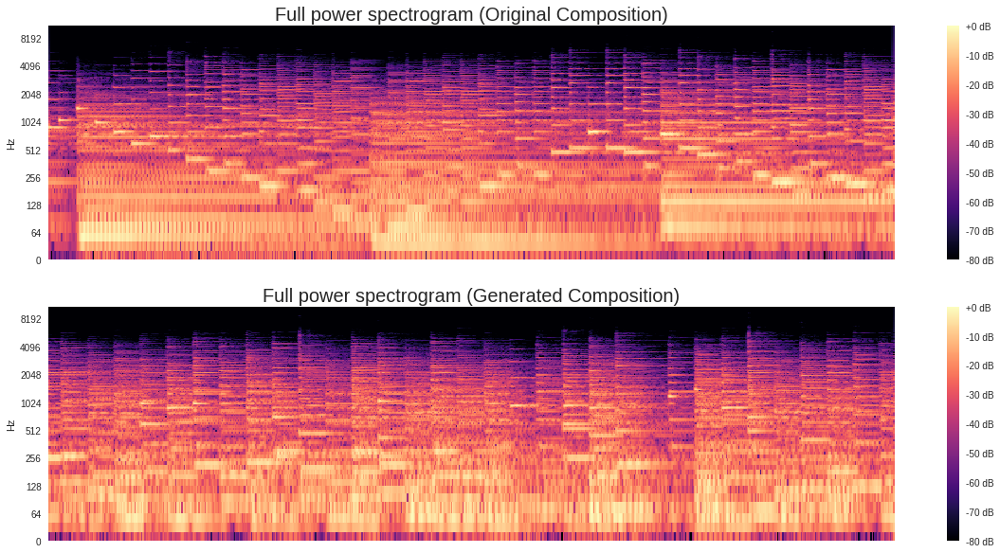

CPU times: user 4.43 s, sys: 2.46 s, total: 6.89 s
Wall time: 4.08 s


In [118]:
%%time
figsize(20, 10)

spec_1 = make_clip(mono_ori, 4)
spec_2 = make_clip(mono_gen, 4)

D_ori = librosa.stft(spec_1, n_fft=2048/2)
D_gen = librosa.stft(spec_2, n_fft=2048/2)

plt.figure(1)
plt.subplot(211)
librosa.display.specshow(librosa.amplitude_to_db(D_ori, ref=np.max), y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('Full power spectrogram (Original Composition)', size = 20)

plt.subplot(212)
librosa.display.specshow(librosa.amplitude_to_db(D_gen, ref=np.max), y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('Full power spectrogram (Generated Composition)', size = 20)

plt.savefig("Full Power Spectrogram.png") 
plt.show()

In [119]:
IPython.display.Audio(data=spec_1, rate=fs)

In [120]:
IPython.display.Audio(data=spec_2, rate=fs)

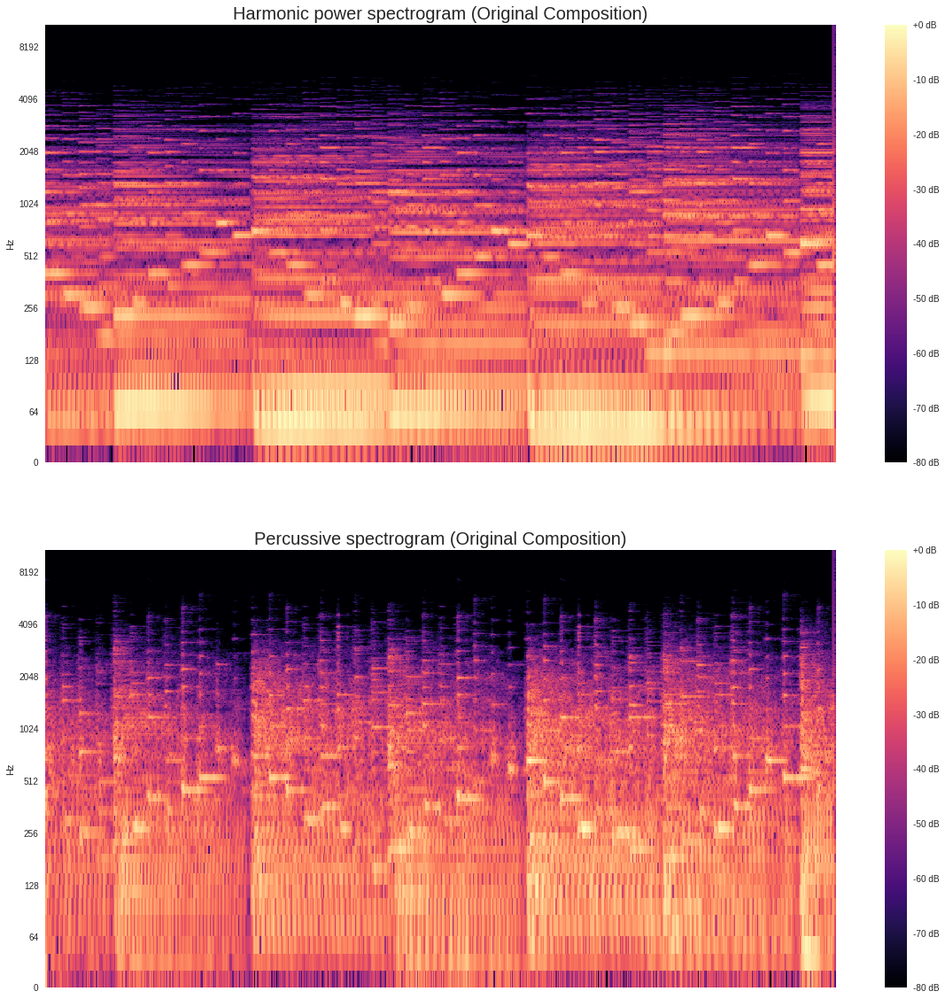

CPU times: user 3.61 s, sys: 1.33 s, total: 4.94 s
Wall time: 3.43 s


In [57]:
%%time
mono_ori_harm, mono_ori_perc = librosa.effects.hpss(spec_1)
mono_gen_harm, mono_gen_perc = librosa.effects.hpss(spec_2)

h_ori = librosa.stft(mono_ori_harm, n_fft=2048/2)
p_ori = librosa.stft(mono_ori_perc, n_fft=2048/2)
h_gen = librosa.stft(mono_gen_harm, n_fft=2048/2)
p_gen = librosa.stft(mono_gen_perc, n_fft=2048/2)

plt.figure(1)
plt.subplot(211)
librosa.display.specshow(librosa.amplitude_to_db(h_ori, ref=np.max), y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('Harmonic power spectrogram (Original Composition)', size = 20)
plt.subplot(212)
librosa.display.specshow(librosa.amplitude_to_db(p_ori, ref=np.max), y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('Percussive spectrogram (Original Composition)', size = 20)
plt.show()

In [61]:
IPython.display.Audio(data=mono_ori_harm, rate=fs)

In [62]:
IPython.display.Audio(data=mono_ori_perc, rate=fs)

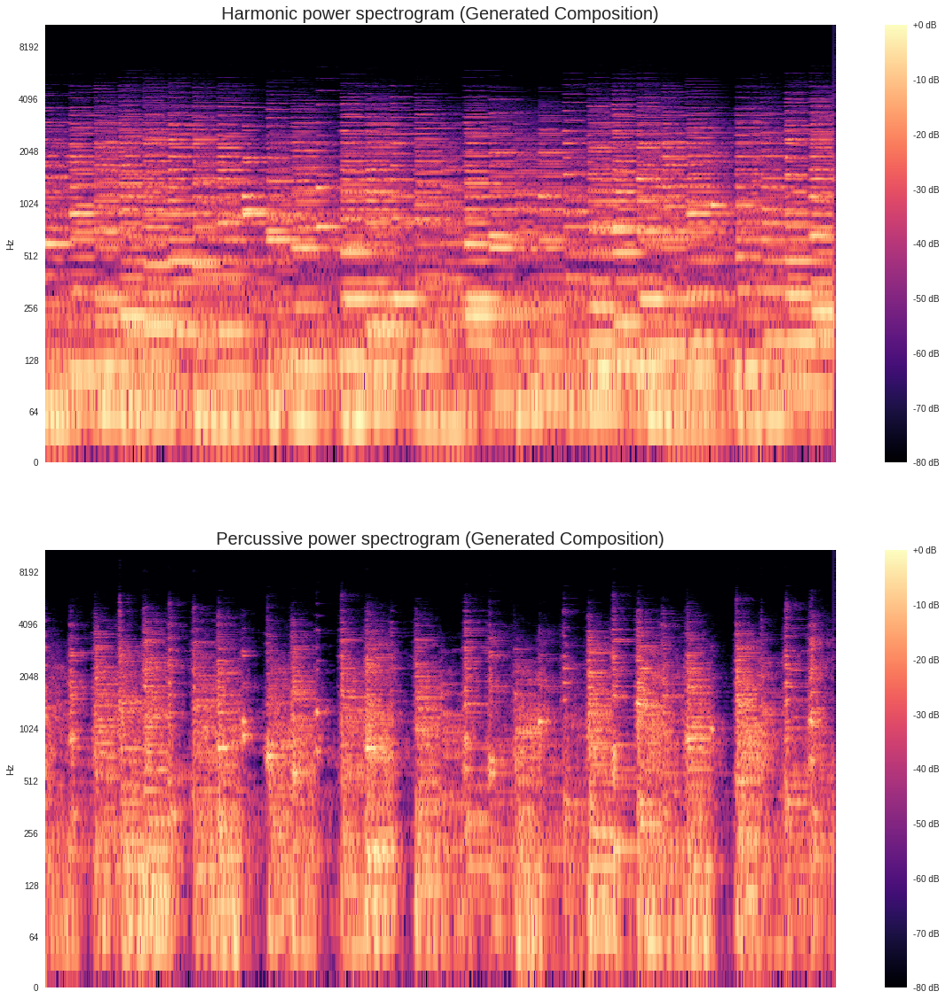

In [58]:
plt.figure(2)
plt.subplot(211)
librosa.display.specshow(librosa.amplitude_to_db(h_gen, ref=np.max), y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('Harmonic power spectrogram (Generated Composition)', size = 20)
plt.subplot(212)
librosa.display.specshow(librosa.amplitude_to_db(p_gen, ref=np.max), y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('Percussive power spectrogram (Generated Composition)', size = 20)
plt.show()

In [63]:
IPython.display.Audio(data=mono_gen_harm, rate=fs)

In [64]:
IPython.display.Audio(data=mono_gen_perc, rate=fs)